In [33]:
library('ggplot2')
library('reshape2')
library('ggpubr')
library(glmnet)
library(doMC)
library(survival)
library(data.table)
library(mltools)
library(CoxBoost)
library(randomForestSRC)
library(CoxHD)
library(Hmisc)
library(gridExtra)
library("survminer")
source("../../../../src/tools.R")
options(repr.plot.res        = 100, # set a medium-definition resolution for the jupyter notebooks plots (DPI)
        repr.matrix.max.rows = 250, # set the maximum number of rows displayed
        repr.matrix.max.cols = 250) # set the maximum number of columns displayed

SVM is used as an intermediary because it comes from python and then it is integrated to each feature usage datasets.

In [34]:
SVM <- read.table("../Prognosis_results/SVM.csv",sep=',',header=T)

### ELN COMP AGE CLIN is performing the best and is not using lots of variables!

# PART 1 WITH NEURAL NETS COMPARISON

In [35]:

list_models <- grep(list.files(path="../Prognosis_results_eln_stratified"), pattern='.R|.csv|neural_network', inv=T, value=T)
df_w_all <-NULL
for (l in list_models){
  #tmp <- cbind(read.table(paste("final_prognosis",l,sep="/"))[1:10,],SVM_optimized=SVM[,substr(l,1,nchar(l)-4)])
  try(tmp <- cbind(read.table(paste("../Prognosis_results_eln_stratified",l,sep="/")),SVM_optimized=SVM[,substr(l,1,nchar(l)-4)]))
  try(tmp$RFS_1_20 <- NULL)
  try(if(tmp[1,]$RFX_==0.5){
      tmp$RFX_ <- median(as.matrix(tmp[,!(colnames(tmp) == "RFX_")]))
      })
  try(tmp$model <- substr(l,1,nchar(l)-4))
  
  try(assign(substr(l,1,nchar(l)-4),melt(tmp,id='model')) )
  try(df_w_all <- rbind(df_w_all,get(substr(l,1,nchar(l)-4))))
}
## add dl
#w <- data.frame(model=rep('all_features',10),variable=rep("deep neural network",10),value=val_dl)
df_w_all <- rbind(read.table("../Prognosis_results/neural_network_all_features.tsv"),df_w_all)
colnames(df_w_all) <- c('model','algorithm','CI_test')
model_medians<-c()
df_w_all$model<-factor(df_w_all$model,levels=substr(list_models,1,nchar(list_models)-4))
df_w_all$median <- 0
for( model in levels(df_w_all$model)){
   df_w_all[df_w_all$model==as.character(model),]$median <- median(df_w_all$CI_test[df_w_all$model==as.character(model)],na.rm=T)
}
df_w_all <- df_w_all[order(df_w_all$median,decreasing=T),]
df_w_all$model<-factor(df_w_all$model,levels=unique(df_w_all$model))

model_medians <- df_w_all[,c("model","median")][!duplicated(df_w_all[,c("model","median")]), ]

Error in `[.data.frame`(SVM, , substr(l, 1, nchar(l) - 4)) : 
  undefined columns selected


In [36]:
###### Preparation worst and best

In [37]:
top <- model_medians[model_medians$median>0.71,]
worst <- model_medians[model_medians$median<0.635,]
df_w_top <- df_w_all[is.element(df_w_all$model,unique(top$model)),]
df_w_worst <- df_w_all[is.element(df_w_all$model,unique(worst$model)),]

##### Conclusion: Clinical and demographical are the more important features for the prognosis models.
##### The eln is also an important parameter because it is solo and it definitely imporves prognosis

##### Of course adding genetical and cytogenetical data slightly improve the overallsurvival prognosis.
##### Adding genetical information or cytogenetical information of component information has the same effect on prognosis when we have clinical and demographical features used for evaluation.

# ALL MODELS

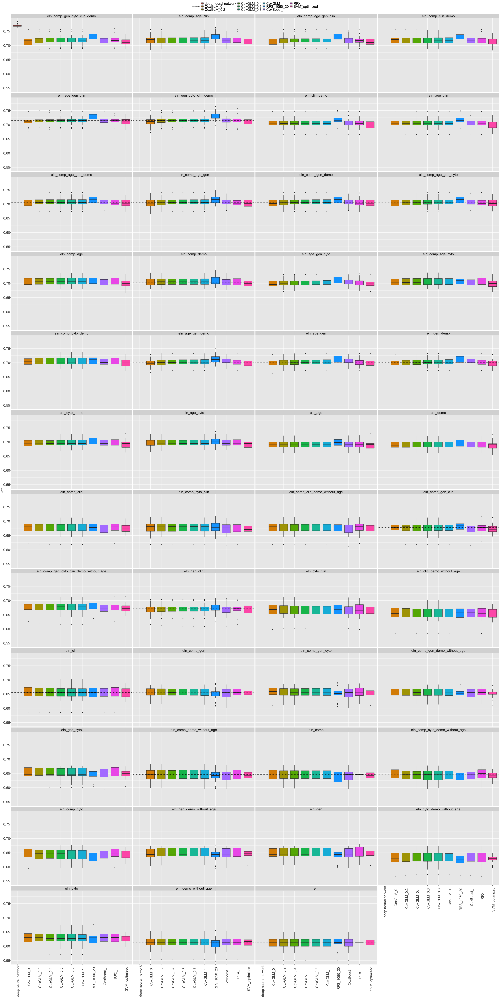

In [38]:
# For ordering Facets by decreasing order :
set_notebook_plot_size(40,80)

ggplot(df_w_all,aes(x=algorithm,y=CI_test)) +
    geom_boxplot(aes(fill = algorithm), notch=F)+
    #scale_fill_manual(values = c('#8dd3c7','#ffffb3','#bebada','#fb8072','#80b1d3','#fdb462','#b3de69'))+
    facet_wrap( ~ model, ncol=4) +
    geom_hline(data = model_medians, aes(yintercept = median), linetype = 2)+
    theme(legend.position="top",strip.text = element_text(size=20),axis.text.x = element_text(size=20,angle = 90, hjust = 0.8,vjust=0.8),axis.text.y =element_text(size=20),legend.text=element_text(size=20)) +xlab("")

# TOP MODELS >0.71

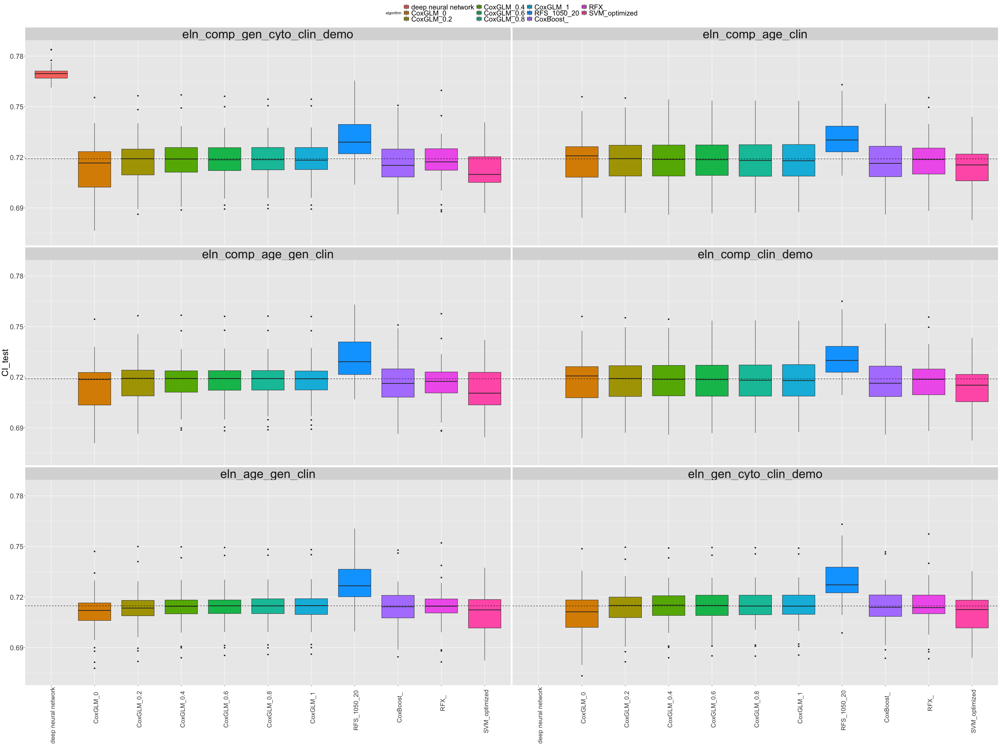

In [39]:
set_notebook_plot_size(40,30)
ggplot(df_w_top,aes(x=algorithm,y=CI_test)) +
    geom_boxplot(aes(fill = algorithm), notch=F)+
    #scale_fill_manual(values = c('#8dd3c7','#ffffb3','#bebada','#fb8072','#80b1d3','#fdb462','#b3de69'))+
    facet_wrap( ~ model, ncol=2) +
    geom_hline(data = top, aes(yintercept = median), linetype = 2)+
    theme(strip.text = element_text(size=35),legend.position="top",axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=18),axis.text.y = element_text(size=20),axis.title.y=element_text(size=25),legend.text=element_text(size=20)) +
    xlab("")

### For the good models, we have a trend and RFD do better than others (lots of features).
######This might be explained by the fact that the GLM Models are not able to perform feature selection if there are too many features.

# WORST MODELS <0.635

#### Increasing Order

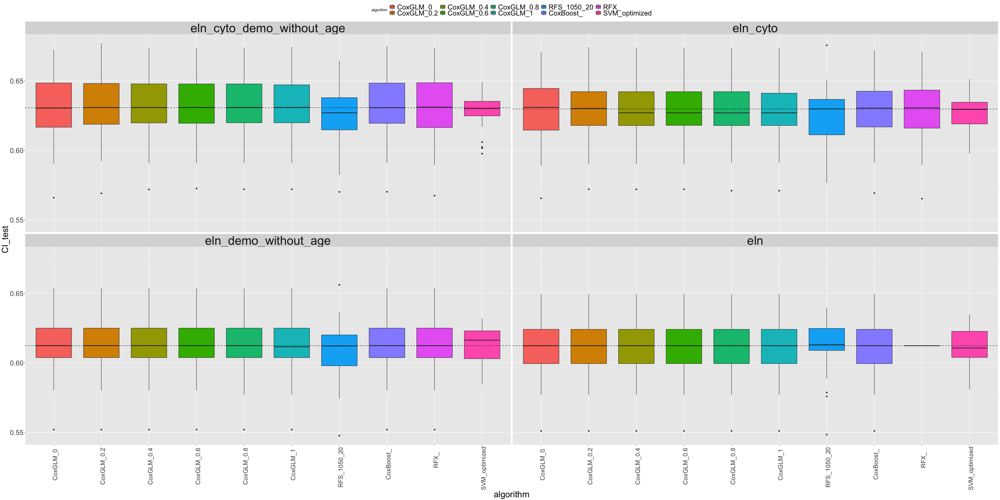

In [40]:
set_notebook_plot_size(40,20)
ggplot(df_w_worst,aes(x=algorithm,y=CI_test)) +
    geom_boxplot(aes(fill = algorithm), notch=F)+
    #scale_fill_manual(values = c('#8dd3c7','#ffffb3','#bebada','#fb8072','#80b1d3','#fdb462','#b3de69'))+
    facet_wrap( ~ model, ncol=2) +
    geom_hline(data = worst, aes(yintercept = median), linetype = 2)+
    theme(strip.text = element_text(size=35),legend.position="top",axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=18),
    axis.text.y = element_text(size=20),axis.title.y=element_text(size=25),axis.title.x=element_text(size=25),legend.text=element_text(size=20))  #+ylim(0.6,0.66)








### We prove it when we look at the worse models :
GLM perform better than RFS

### Model and Algorithms Performance visualization 

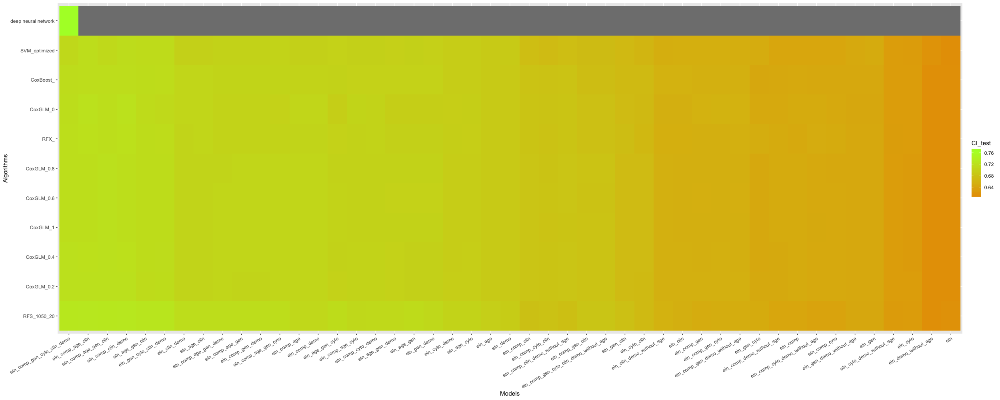

In [41]:
set_notebook_plot_size(25,10)
#nrow = number of prognosis models 
#ncol = number of feature models
table_res <- as.data.frame(matrix(0,nrow =length(unique(df_w_all$algorithm)), ncol=length(model_medians$model)))
colnames(table_res)<-levels(df_w_all$model)
rownames(table_res)<-levels(df_w_all$algorithm)

for(model in colnames(table_res)){
    for(algo in rownames(table_res)){
        table_res[algo,model]<-median(df_w_all$CI_test[df_w_all$model==model & df_w_all$algorithm==algo])
    }
}
row_names <-rownames(table_res)
table_res$algo<-rownames(table_res)
rownames(table_res)<-NULL
table_res<-melt(table_res,id='algo')
colnames(table_res)<-c('algo','model','CI_test')
table_res$algo<-factor(table_res$algo,levels=row_names)
table_res$model<-factor(table_res$model)
ggplot(table_res, aes(x=reorder(model,-CI_test), reorder(algo,-CI_test))) +
    geom_raster(aes(fill = CI_test), show.legend = TRUE) +
    scale_fill_gradient(low="#e79f00", high="greenyellow") +
    tilt_x_label(30) +
    ylab("Algorithms") +
    xlab("Models")
    

# Model Performance Evaluation

# I) By Model

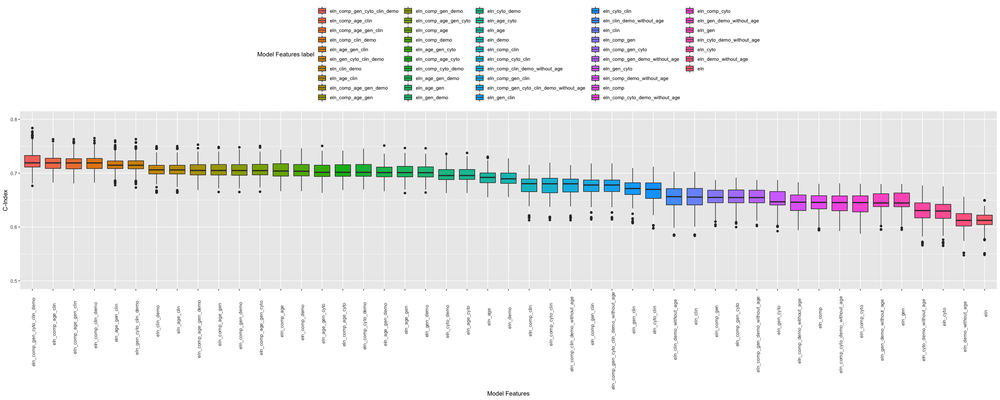

In [42]:
set_notebook_plot_size(25,10)
#ggplot(df_w_all, aes(x=reorder(model, -CI_test),y=CI_test))+
#geom_boxplot(aes(fill =reorder(model, -CI_test)), notch=F)+
ggplot(df_w_all, aes(x=model,y=CI_test))+
geom_boxplot(aes(fill =model), notch=F)+
theme(legend.position="top",axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8))+ylim(0.50,0.8)+xlab("Model Features")+ylab("C-Index")+labs(fill = " Model Features label")

#### comp clin demo doing better than gen cyto clin demo suggesting that it capture all the gen and cyto info!

# II) By Algorithm

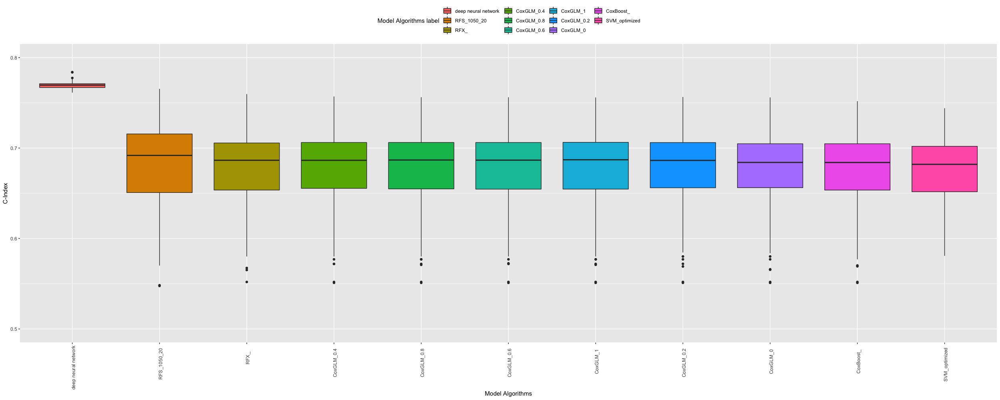

In [43]:
set_notebook_plot_size(25,10)
ggplot(df_w_all, aes(x=reorder(algorithm, -CI_test),y=CI_test))+
geom_boxplot(aes(fill =reorder(algorithm, -CI_test)), notch=F)+
theme(legend.position="top",axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8))+ylim(0.5,0.8)+xlab("Model Algorithms")+ylab("C-Index")+labs(fill = " Model Algorithms label")

# PART 2 FAIR COMPARISON

In [44]:

list_models <- grep(list.files(path="../Prognosis_results_eln_stratified"), pattern='.R|.csv|neural_network', inv=T, value=T)
df_w_all <-NULL
for (l in list_models){
  #tmp <- cbind(read.table(paste("final_prognosis",l,sep="/"))[1:10,],SVM_optimized=SVM[,substr(l,1,nchar(l)-4)])
  try(tmp <- cbind(read.table(paste("../Prognosis_results_eln_stratified",l,sep="/")),SVM_optimized=SVM[,substr(l,1,nchar(l)-4)]))
  try(tmp$RFS_1_20 <- NULL)
  try(if(tmp[1,]$RFX_==0.5){
      tmp$RFX_ <- median(as.matrix(tmp[,!(colnames(tmp) == "RFX_")]))
      })
  try(tmp$model <- substr(l,1,nchar(l)-4))
  
  try(assign(substr(l,1,nchar(l)-4),melt(tmp,id='model')) )
  try(df_w_all <- rbind(df_w_all,get(substr(l,1,nchar(l)-4))))
}
## add dl
#df_w_all <- rbind(read.table("../Prognosis_results/neural_network_all_features.tsv"),df_w_all)
colnames(df_w_all) <- c('model','algorithm','CI_test')
model_medians<-c()
df_w_all$model<-factor(df_w_all$model,levels=substr(list_models,1,nchar(list_models)-4))
df_w_all$median <- 0
for( model in levels(df_w_all$model)){
   df_w_all[df_w_all$model==as.character(model),]$median <- median(df_w_all$CI_test[df_w_all$model==as.character(model)],na.rm=T)
}
df_w_all <- df_w_all[order(df_w_all$median,decreasing=T),]
df_w_all$model<-factor(df_w_all$model,levels=unique(df_w_all$model))

model_medians <- df_w_all[,c("model","median")][!duplicated(df_w_all[,c("model","median")]), ]

Error in `[.data.frame`(SVM, , substr(l, 1, nchar(l) - 4)) : 
  undefined columns selected


In [45]:
###### Preparation worst and best

In [46]:
top <- model_medians[model_medians$median>0.71,]
worst <- model_medians[model_medians$median<0.635,]
df_w_top <- df_w_all[is.element(df_w_all$model,unique(top$model)),]
df_w_worst <- df_w_all[is.element(df_w_all$model,unique(worst$model)),]

##### Conclusion: Clinical and demographical are the more important features for the prognosis models.
##### The eln is also an important parameter because it is solo and it definitely imporves prognosis

##### Of course adding genetical and cytogenetical data slightly improve the overallsurvival prognosis.
##### Adding genetical information or cytogenetical information of component information has the same effect on prognosis when we have clinical and demographical features used for evaluation.

# ALL MODELS

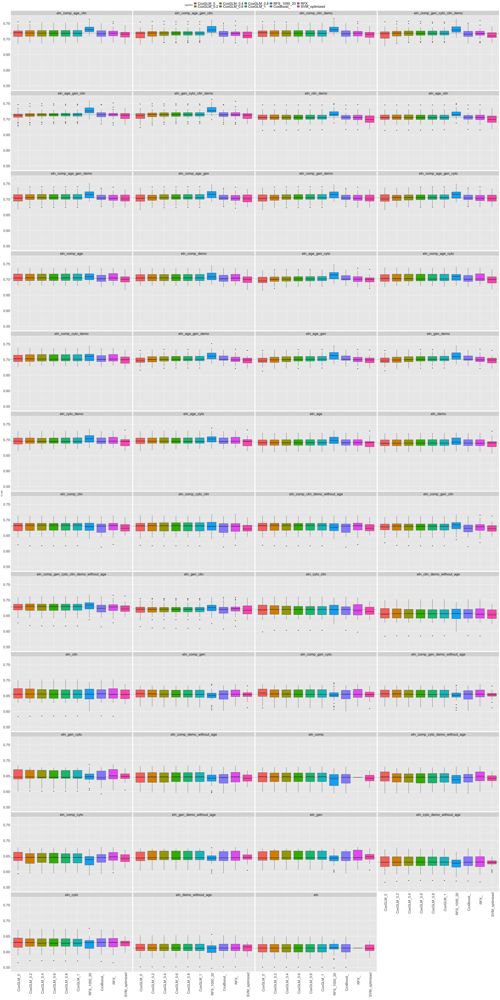

In [47]:
# For ordering Facets by decreasing order :
set_notebook_plot_size(40,80)

ggplot(df_w_all,aes(x=algorithm,y=CI_test)) +
    geom_boxplot(aes(fill = algorithm), notch=F)+
    #scale_fill_manual(values = c('#8dd3c7','#ffffb3','#bebada','#fb8072','#80b1d3','#fdb462','#b3de69'))+
    facet_wrap( ~ model, ncol=4) +
    geom_hline(data = model_medians, aes(yintercept = median), linetype = 2)+
    theme(legend.position="top",strip.text = element_text(size=20),axis.text.x = element_text(size=20,angle = 90, hjust = 0.8,vjust=0.8),axis.text.y =element_text(size=20),legend.text=element_text(size=20)) +xlab("")

# TOP MODELS >0.71

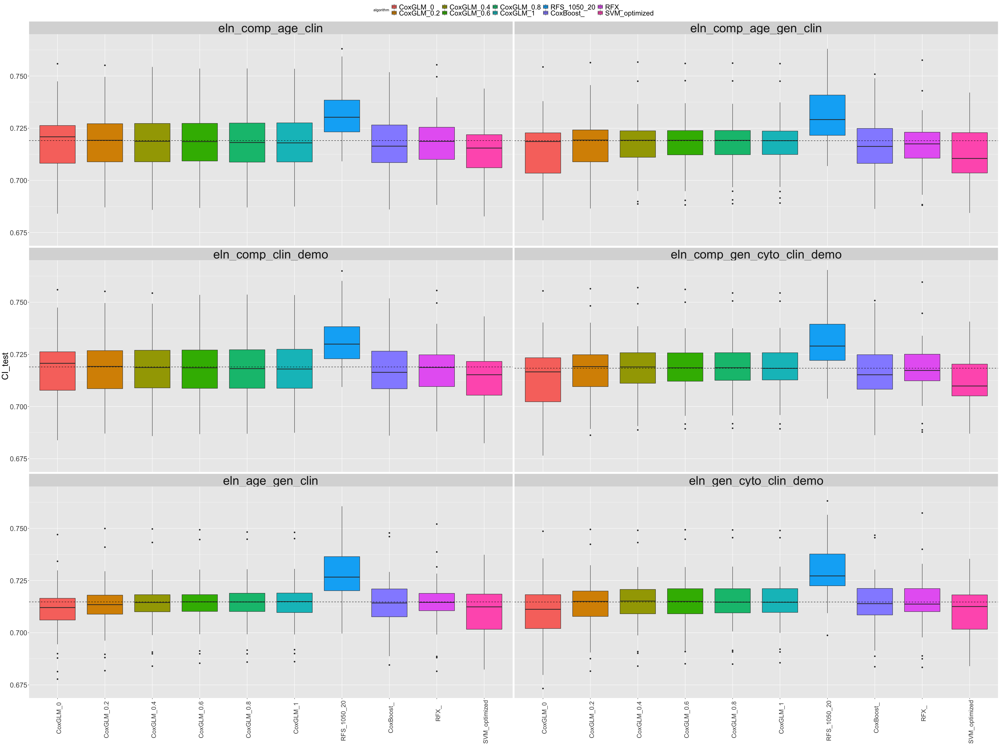

In [48]:
set_notebook_plot_size(40,30)
ggplot(df_w_top,aes(x=algorithm,y=CI_test)) +
    geom_boxplot(aes(fill = algorithm), notch=F)+
    #scale_fill_manual(values = c('#8dd3c7','#ffffb3','#bebada','#fb8072','#80b1d3','#fdb462','#b3de69'))+
    facet_wrap( ~ model, ncol=2) +
    geom_hline(data = top, aes(yintercept = median), linetype = 2)+
    theme(strip.text = element_text(size=35),legend.position="top",axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=18),axis.text.y = element_text(size=20),axis.title.y=element_text(size=25),legend.text=element_text(size=20)) +
    xlab("")

### For the good models, we have a trend and RFD do better than others (lots of features).
######This might be explained by the fact that the GLM Models are not able to perform feature selection if there are too many features.

# WORST MODELS <0.635

#### Increasing Order

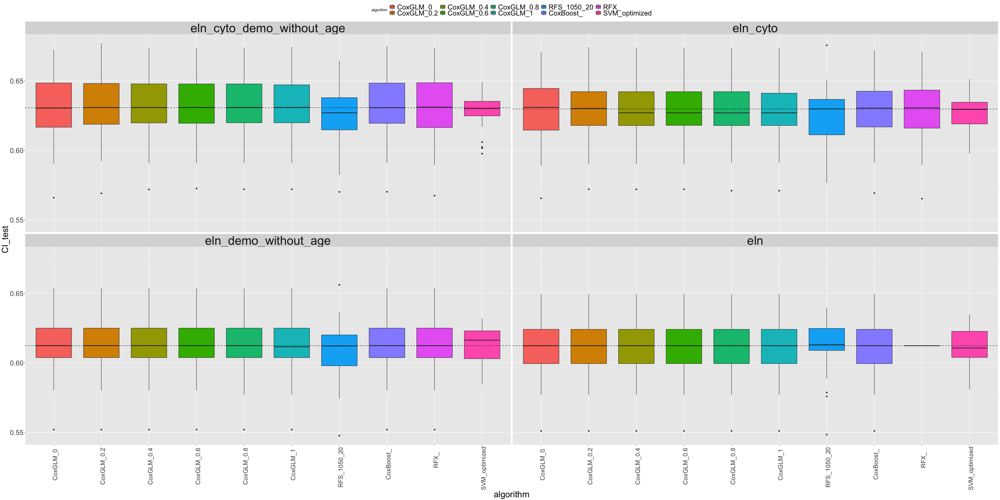

In [49]:
set_notebook_plot_size(40,20)
ggplot(df_w_worst,aes(x=algorithm,y=CI_test)) +
    geom_boxplot(aes(fill = algorithm), notch=F)+
    #scale_fill_manual(values = c('#8dd3c7','#ffffb3','#bebada','#fb8072','#80b1d3','#fdb462','#b3de69'))+
    facet_wrap( ~ model, ncol=2) +
    geom_hline(data = worst, aes(yintercept = median), linetype = 2)+
    theme(strip.text = element_text(size=35),legend.position="top",axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=18),
    axis.text.y = element_text(size=20),axis.title.y=element_text(size=25),axis.title.x=element_text(size=25),legend.text=element_text(size=20))  #+ylim(0.6,0.66)








### We prove it when we look at the worse models :
GLM perform better than RFS

### Model and Algorithms Performance visualization 

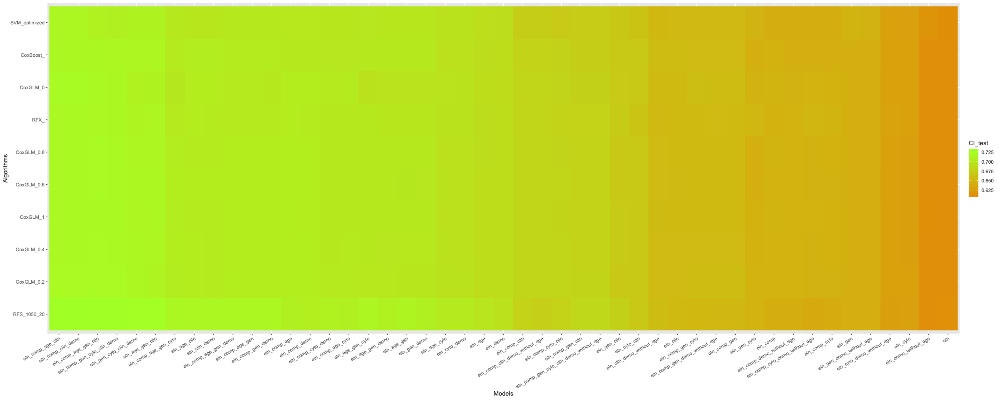

In [50]:
set_notebook_plot_size(25,10)
#nrow = number of prognosis models 
#ncol = number of feature models
table_res <- as.data.frame(matrix(0,nrow =length(unique(df_w_all$algorithm)), ncol=length(model_medians$model)))
colnames(table_res)<-levels(df_w_all$model)
rownames(table_res)<-levels(df_w_all$algorithm)

for(model in colnames(table_res)){
    for(algo in rownames(table_res)){
        table_res[algo,model]<-median(df_w_all$CI_test[df_w_all$model==model & df_w_all$algorithm==algo])
    }
}
row_names <-rownames(table_res)
table_res$algo<-rownames(table_res)
rownames(table_res)<-NULL
table_res<-melt(table_res,id='algo')
colnames(table_res)<-c('algo','model','CI_test')
table_res$algo<-factor(table_res$algo,levels=row_names)
table_res$model<-factor(table_res$model)
ggplot(table_res, aes(x=reorder(model,-CI_test), reorder(algo,-CI_test))) +
    geom_raster(aes(fill = CI_test), show.legend = TRUE) +
    scale_fill_gradient(low="#e79f00", high="greenyellow") +
    tilt_x_label(30) +
    ylab("Algorithms") +
    xlab("Models")
    

# Model Performance Evaluation

# I) By Model

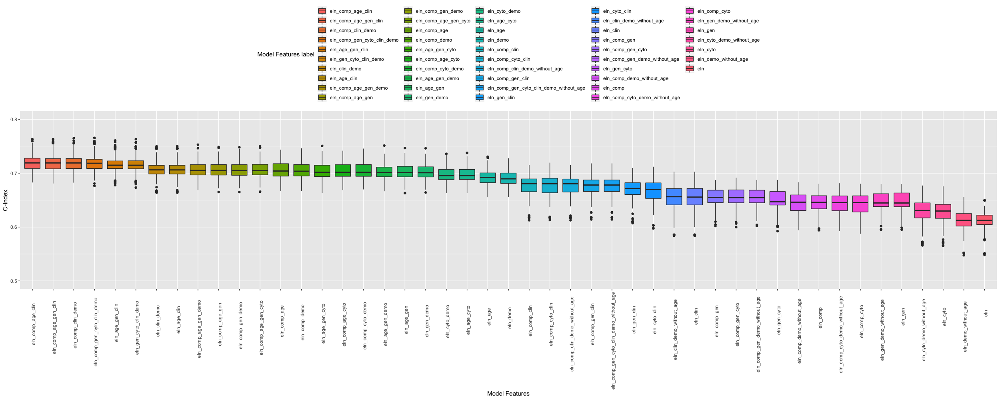

In [51]:
set_notebook_plot_size(25,10)
#ggplot(df_w_all, aes(x=reorder(model, -CI_test),y=CI_test))+
#geom_boxplot(aes(fill =reorder(model, -CI_test)), notch=F)+
ggplot(df_w_all, aes(x=model,y=CI_test))+
geom_boxplot(aes(fill =model), notch=F)+
theme(legend.position="top",axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8))+ylim(0.50,0.8)+xlab("Model Features")+ylab("C-Index")+labs(fill = " Model Features label")

#### comp clin demo doing better than gen cyto clin demo suggesting that it capture all the gen and cyto info!

# II) By Algorithm

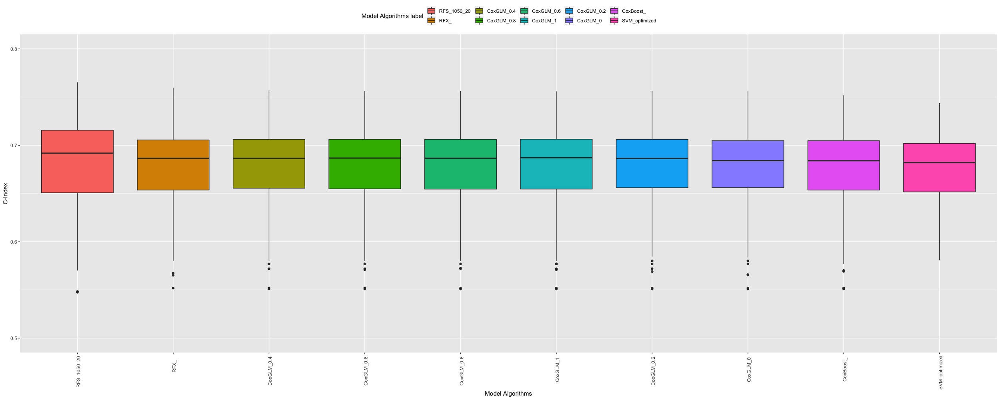

In [52]:
set_notebook_plot_size(25,10)
ggplot(df_w_all, aes(x=reorder(algorithm, -CI_test),y=CI_test))+
geom_boxplot(aes(fill =reorder(algorithm, -CI_test)), notch=F)+
theme(legend.position="top",axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8))+ylim(0.5,0.8)+xlab("Model Algorithms")+ylab("C-Index")+labs(fill = " Model Algorithms label")

#  Test Cox PH Assumptions

In [53]:
options(warn=-1)
df_final <- read.table("../data_frame_final_prognosis.tsv")

eln <- c(1)
comp <- c(164:178)
age <- c(163)
all_gen <- c(2:85)
vect <- apply(X=df_final[,all_gen],2,FUN=function(x) 100*length(which(x==1))/dim(df_final)[1])
gen <- match(names(vect[vect>=2]),names(df_final))
all_cyto <- c(86:154)
vect <- apply(X=df_final[,all_cyto],2,FUN=function(x) 100*length(which(x==1))/dim(df_final)[1])
cyto <- match(names(vect[vect>=2]),names(df_final))
clin <- c(155:161)
demo <- c(162:163)


eln_comp_gen_cyto_clin_demo <- c(eln,comp,gen,cyto,clin,demo)

set_notebook_plot_size(100,100)
f1 <- as.formula(paste("Surv(os, os_status) ~ ",
                       paste(colnames(df_final[,eln_comp_gen_cyto_clin_demo]), collapse= "+")))
res.cox <- coxph(f1,data=df_final)
test.ph <- cox.zph(res.cox)
par(mfrow=c(2,5))
ggcoxzph(test.ph)

